In [6]:
import pandas as pd

# Define the paths to the CSV files
csv_file_1 = '/content/0021801221-mia-vs-bkn.csv'
csv_file_2 = '/content/0021801227-dal-vs-sas.csv'
csv_file_3 = '/content/0021801229-uta-vs-lac.csv'

# Read the CSV files into DataFrames
df1 = pd.read_csv(csv_file_1)
df2 = pd.read_csv(csv_file_2)
df3 = pd.read_csv(csv_file_3)

# Combine the DataFrames
combined_df = pd.concat([df1, df2, df3], ignore_index=True)

# Save the combined DataFrame to a new CSV file
combined_csv_file = 'combined.csv'
combined_df.to_csv(combined_csv_file, index=False)



In [7]:
import csv
import os
import re
from urllib.request import urlretrieve
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Define the subfolder in Google Drive for downloaded videos
drive_video_folder = "/content/drive/MyDrive/Downloaded videos"

# Create the video folder in Google Drive if it doesn't exist
if not os.path.exists(drive_video_folder):
    os.makedirs(drive_video_folder)

# Open the CSV file in read and write mode with newline handling
with open('combined.csv', 'r+', newline='') as csvfile:

    # Create reader object
    reader = csv.reader(csvfile)

    # Read all rows into a list `data`
    data = list(reader)

    # Create writer object (after reading data)
    writer = csv.writer(csvfile)  # Moved writer creation here

    # Check if "video_dir_path" is in the header and create it if not
    if 'video_dir_path' not in data[0]:
        data[0].append('video_dir_path')
        writer.writerow(data[0])  # Write updated header with new column

    # Loop through rows starting from the second row (skip header)
    for idx, row in enumerate(data[1:]):
        video_url = row[21]  # Assuming video_url is at index 21

        # Extract filename from the cleaned video_url
        filename = video_url.split('/')[-1]

        # Define the full path in Google Drive
        video_path = os.path.join(drive_video_folder, filename)

        # Check if video file already exists
        if os.path.isfile(video_path):
            print(f"Video {filename} already exists, skipping download.")
            row.append(video_path)  # Update row with existing path
        else:
            try:
                # Remove leading/trailing spaces and any extra spaces within the URL
                video_url = video_url.strip()
                video_url = re.sub(r'\s+', '', video_url)

                # Download video
                urlretrieve(video_url, video_path)

                # Update the row with downloaded video path
                row.append(video_path)

                # Move the pointer to the beginning (overwrite header and row)
                csvfile.seek(0, os.SEEK_SET)
                writer.writerow(data[0])  # Write header again
                writer.writerow(row)      # Write updated row

                # Move the pointer back to the next row position
                csvfile.seek((idx + 2) * len(csvfile.readline()), os.SEEK_SET)
                print(f"Downloaded video: {filename}")
            except Exception as e:
                print(f"Error downloading video {filename}: {e}")

print("Video download process completed.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Video 61ecd9bc-29d0-965e-6f76-8cf5a4591861_1280x720.mp4 already exists, skipping download.
Video cde42fa1-cdbb-3477-3956-70ae9fd385bb_1280x720.mp4 already exists, skipping download.
Video 76006302-0e1a-0795-9e78-fc8f87bf4ccc_1280x720.mp4 already exists, skipping download.
Video 9f962f8d-f01b-3c6c-1251-5b4da01f430b_1280x720.mp4 already exists, skipping download.
Video 0ddce56d-19c4-59f4-e350-844e8d38423d_1280x720.mp4 already exists, skipping download.
Video 9102071c-5cf7-80fd-066e-3a127a21946c_1280x720.mp4 already exists, skipping download.
Video d3c7fd8e-abfb-8af4-092b-bc94d333e477_1280x720.mp4 already exists, skipping download.
Video 7cad29bd-81b1-5022-47b7-b0e1f3627535_1280x720.mp4 already exists, skipping download.
Video 313622a1-4ad8-af14-6e12-00a3f26463e3_1280x720.mp4 already exists, skipping download.
Video 6bf6526e-c7b0-1d7c-6ed7-6c29d1126ee2_1280x720.

In [8]:
import csv
import os
import re
from urllib.request import urlretrieve
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Define the subfolder in Google Drive for downloaded videos
drive_video_folder = "/content/drive/MyDrive/Downloaded videos"

# Create the video folder in Google Drive if it doesn't exist
if not os.path.exists(drive_video_folder):
    os.makedirs(drive_video_folder)

# Open the combined CSV file
with open('combined.csv', 'r', newline='') as csvfile:
    # Create reader object
    reader = csv.reader(csvfile)
    # Read all rows into a list `data`
    data = list(reader)

# Prepare a list to store rows with downloaded video paths
new_csv_data = [data[0]]  # Start with the header

# Check if "video_dir_path" is in the header and add it if not
if 'video_dir_path' not in data[0]:
    data[0].append('video_dir_path')

# Loop through rows starting from the second row (skip header)
for idx, row in enumerate(data[1:]):
    video_url = row[21]  # Assuming video_url is at index 21

    # Extract filename from the cleaned video_url
    filename = video_url.split('/')[-1]

    # Define the full path in Google Drive
    video_path = os.path.join(drive_video_folder, filename)

    # Check if video file already exists
    if os.path.isfile(video_path):
        print(f"Video {filename} already exists, skipping download.")
        row.append(video_path)  # Update row with existing path
        new_csv_data.append(row)  # Add to new CSV data
    else:
        try:
            # Remove leading/trailing spaces and any extra spaces within the URL
            video_url = video_url.strip()
            video_url = re.sub(r'\s+', '', video_url)

            # Download video
            urlretrieve(video_url, video_path)

            # Update the row with downloaded video path
            row.append(video_path)
            new_csv_data.append(row)  # Add to new CSV data

            print(f"Downloaded video: {filename}")
        except Exception as e:
            print(f"Error downloading video {filename}: {e}")

# Create a new CSV file with the same video URLs
with open('new_combined.csv', 'w', newline='') as new_csvfile:
    writer = csv.writer(new_csvfile)
    writer.writerows(new_csv_data)

print("Video download process completed and new CSV file created.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Video 61ecd9bc-29d0-965e-6f76-8cf5a4591861_1280x720.mp4 already exists, skipping download.
Video cde42fa1-cdbb-3477-3956-70ae9fd385bb_1280x720.mp4 already exists, skipping download.
Video 76006302-0e1a-0795-9e78-fc8f87bf4ccc_1280x720.mp4 already exists, skipping download.
Video 9f962f8d-f01b-3c6c-1251-5b4da01f430b_1280x720.mp4 already exists, skipping download.
Video 0ddce56d-19c4-59f4-e350-844e8d38423d_1280x720.mp4 already exists, skipping download.
Video 9102071c-5cf7-80fd-066e-3a127a21946c_1280x720.mp4 already exists, skipping download.
Video d3c7fd8e-abfb-8af4-092b-bc94d333e477_1280x720.mp4 already exists, skipping download.
Video 7cad29bd-81b1-5022-47b7-b0e1f3627535_1280x720.mp4 already exists, skipping download.
Video 313622a1-4ad8-af14-6e12-00a3f26463e3_1280x720.mp4 already exists, skipping download.
Video 6bf6526e-c7b0-1d7c-6ed7-6c29d1126ee2_1280x720.

In [15]:
newdf=pd.read_csv("new_combined.csv")
newdf.head(5)!pip install opencv-python-headless matplotlib


SyntaxError: invalid syntax (<ipython-input-15-92379e64452f>, line 2)

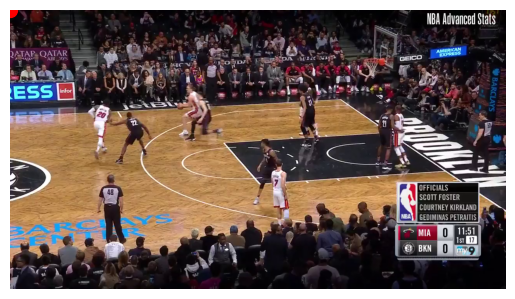

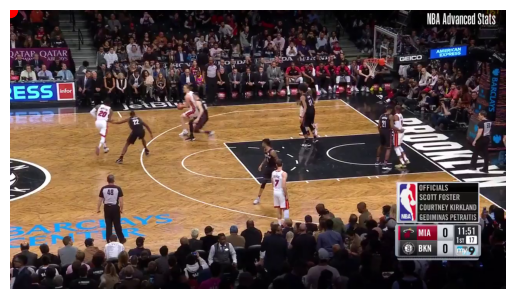

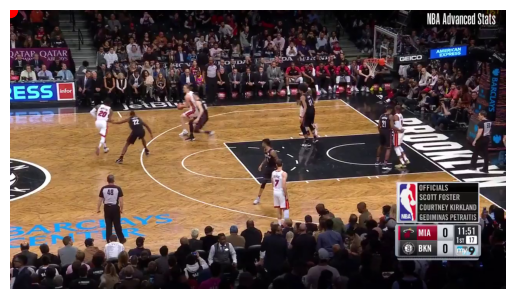

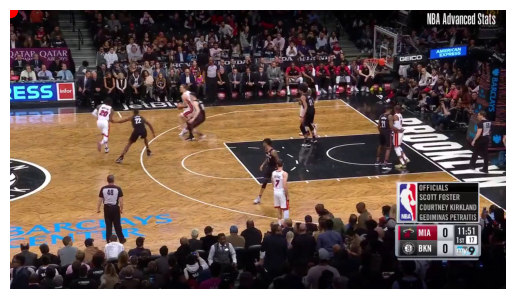

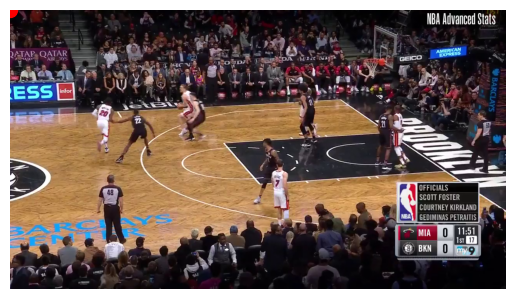

...

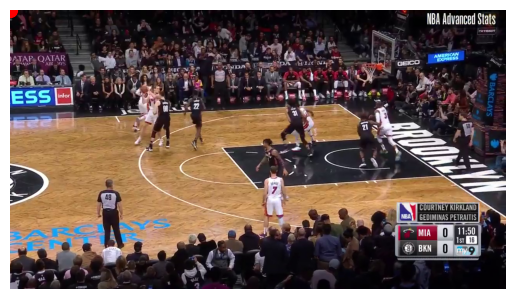

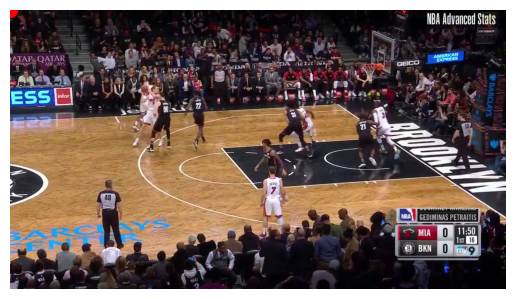

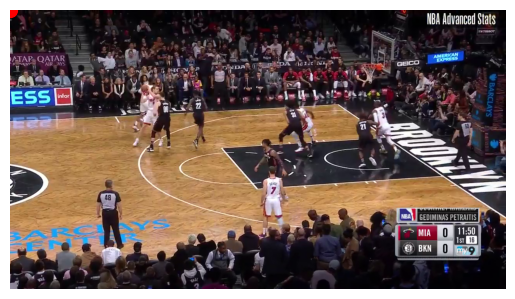

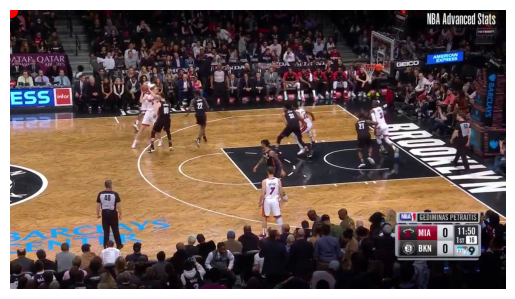

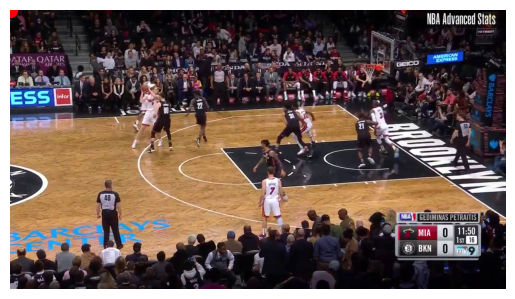

In [ ]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv('new_combined.csv')

# Iterate through each row in the dataframe
for index, row in df.iterrows():
    video_path = row['video_dir_path']
    x_legacy = "-106.0"
    y_legacy = "1.0"

    # Check if the video file exists
    if not os.path.isfile(video_path):
        print(f"Video file {video_path} does not exist.")
        continue

    # Open the video file
    cap = cv2.VideoCapture("/content/drive/MyDrive/Downloaded videos/cde42fa1-cdbb-3477-3956-70ae9fd385bb_1280x720.mp4")

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Plot xLegacy and yLegacy points on the video frame
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.scatter([x_legacy], [y_legacy], color='red', s=100)
        plt.axis('off')  # Turn off axis numbers and ticks
        plt.show()

        # Wait for key press
        key = cv2.waitKey(0)
        if key == 27:  # Press ESC to exit
            break

    cap.release()
    cv2.destroyAllWindows()

In [19]:
column_names = newdf.columns.tolist()

# Print the column names
print("Column names:", column_names)

Column names: ['actionNumber', 'actionType', 'clock', 'description', 'isFieldGoal', 'location', 'period', 'personId', 'playerName', 'playerNameI', 'pointsTotal', 'scoreAway', 'scoreHome', 'shotDistance', 'shotResult', 'subType', 'teamId', 'teamTricode', 'videoAvailable', 'xLegacy', 'yLegacy', 'video_url', 'video_id', 'data_split_id', 'delexicalized_description', 'players_in_description', 'action_type_code', 'video_dir_path']
